## Install MMRotate

In [11]:
# Install MMCV and MMDetection using MIM.
!pip3 install -U openmim
!mim install mmcv-full
!mim install mmdet
# Install tensorboard for data metrics later
!pip install -q tb-nightly

Looking in links: https://download.openmmlab.com/mmcv/dist/cu113/torch1.10.0/index.html


C:\Users\jense\anaconda3\envs\mmyolo\lib\site-packages\setuptools\command\install.py:34: SetuptoolsDeprecationWarning: setup.py install is deprecated. Use build and pip and other standards-based tools.
  warnings.warn(


Looking in links: https://download.openmmlab.com/mmcv/dist/cu113/torch1.10.0/index.html


C:\Users\jense\anaconda3\envs\mmyolo\lib\site-packages\setuptools\command\install.py:34: SetuptoolsDeprecationWarning: setup.py install is deprecated. Use build and pip and other standards-based tools.
  warnings.warn(


In [1]:
# Check nvcc version
!nvcc -V
# Check GCC version
!gcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2021 NVIDIA Corporation
Built on Sun_Mar_21_19:24:09_Pacific_Daylight_Time_2021
Cuda compilation tools, release 11.3, V11.3.58
Build cuda_11.3.r11.3/compiler.29745058_0
gcc (Rev5, Built by MSYS2 project) 5.3.0
Copyright (C) 2015 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [2]:
import torch
# Check pytorch version
print(torch.__version__)
# Check if gpu is available for training
print(torch.cuda.is_available())


1.10.1
True


In [3]:
import os
# Check current directory
%cd ".."
cwd = os.getcwd()
print(cwd)

C:\Users\jense\Documents\Python-Rapid\mmrotate
C:\Users\jense\Documents\Python-Rapid\mmrotate


In [4]:
#from mmcv import collect_env
#collect_env()

# Check MMRotate installation
import mmrotate
print(mmrotate.__version__)

# Check MMDetection installation
import mmdet
print(mmdet.__version__)

# Check mmcv installation
from mmcv.ops import get_compiling_cuda_version, get_compiler_version
print(get_compiling_cuda_version())
print(get_compiler_version())

C:\Users\jense\anaconda3\envs\mmyolo\lib\site-packages\mmcv\__init__.py:20: UserWarning: On January 1, 2023, MMCV will release v2.0.0, in which it will remove components related to the training process and add a data transformation module. In addition, it will rename the package names mmcv to mmcv-lite and mmcv-full to mmcv. See https://github.com/open-mmlab/mmcv/blob/master/docs/en/compatibility.md for more details.
  warnings.warn(


0.3.4
2.28.2
11.3
MSVC 192829924


In [5]:
# We use mim to download the pre-trained checkpoints for inference and finetuning.
!mim download mmrotate --config oriented_rcnn_r50_fpn_1x_dota_le90 --dest .

processing oriented_rcnn_r50_fpn_1x_dota_le90...
oriented_rcnn_r50_fpn_1x_dota_le90-6d2b2ce0.pth exists in C:\Users\jense\Documents\Python-Rapid\mmrotate
Successfully dumped oriented_rcnn_r50_fpn_1x_dota_le90.py to C:\Users\jense\Documents\Python-Rapid\mmrotate


In [6]:
import mmcv
from mmcv.runner import load_checkpoint

from mmdet.apis import inference_detector, show_result_pyplot
from mmrotate.models import build_detector

# Choose to use a config and initialize the detector
config = 'oriented_rcnn_r50_fpn_1x_dota_le90.py'
# Setup a checkpoint file to load
checkpoint = 'oriented_rcnn_r50_fpn_1x_dota_le90-6d2b2ce0.pth'

# Set the device to be used for evaluation
device='cuda:0'

# Load the config
config = mmcv.Config.fromfile(config)
# Set pretrained to be None since we do not need pretrained model here
config.model.pretrained = None

# Initialize the detector
model = build_detector(config.model)

# Load checkpoint
checkpoint = load_checkpoint(model, checkpoint, map_location=device)

# Set the classes of models for inference
model.CLASSES = checkpoint['meta']['CLASSES']

# We need to set the model's cfg for inference
model.cfg = config

# Convert the model to GPU
model.to(device)
# Convert the model into evaluation mode
model.eval()

C:\Users\jense\anaconda3\envs\mmyolo\lib\site-packages\mmdet\models\dense_heads\anchor_head.py:116: UserWarning: DeprecationWarning: `num_anchors` is deprecated, for consistency or also use `num_base_priors` instead
  warnings.warn('DeprecationWarning: `num_anchors` is deprecated, '


load checkpoint from local path: oriented_rcnn_r50_fpn_1x_dota_le90-6d2b2ce0.pth


OrientedRCNN(
  (backbone): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): ResLayer(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
      

From the printed model, we will find that the model does consist of the components that we described earlier. It uses ResNet as its CNN backbone, and has a RPN head and RoI Head. In addition, the model has a neural network module, named neck, directly after the CNN backbone. It is a [feature pyramid network (FPN)](https://arxiv.org/abs/1612.03144) for enhancing the multi-scale features.


### Inference the detector

Since the model is successfully created and loaded, let's see how good it is. We use the high-level API `inference_detector` implemented in the MMDetection. This API is created to ease the inference process. The details of the codes can be found [here](https://github.com/open-mmlab/mmdetection/blob/master/mmdet/apis/inference.py#L15).

In [8]:
# Use the detector to do inference
import os
print(os.getcwd())
img = 'demo/demo.jpg'
result = inference_detector(model, img)

C:\Users\jense\Documents\Python-Rapid\mmrotate


C:\Users\jense\anaconda3\envs\mmyolo\lib\site-packages\mmdet\models\dense_heads\anchor_head.py:123: UserWarning: DeprecationWarning: anchor_generator is deprecated, please use "prior_generator" instead
  warnings.warn('DeprecationWarning: anchor_generator is deprecated, '


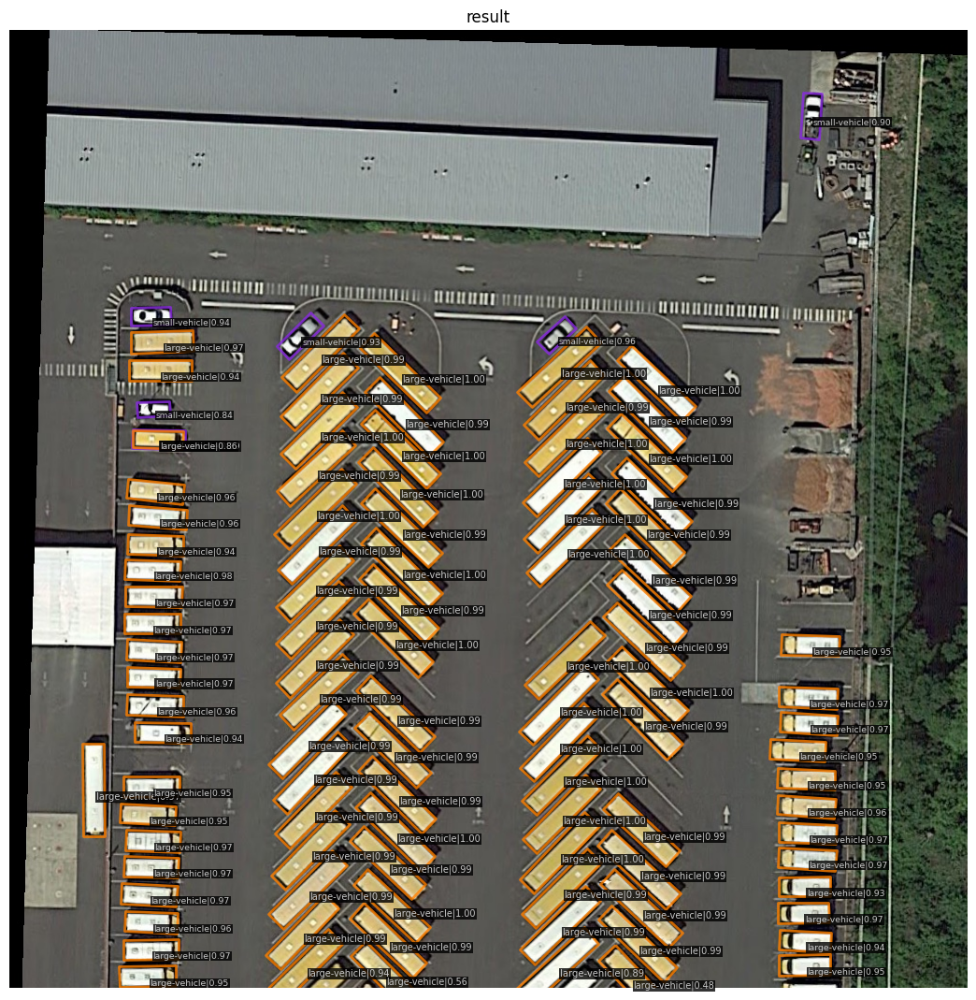

In [9]:
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.3, palette='dota')

### Inference on huge image
Since small image can be successfully detected, what about huge images in remote sensing? We use the high-level API `inference_detector_by_patches` implemented in the MMRotate. This API is created to ease the inference process for huge image. The details of the codes can be found [here](https://github.com/open-mmlab/mmrotate/blob/dev/mmrotate/apis/inference.py).

In [13]:
# Use the detector to do inference
from mmrotate.apis import inference_detector_by_patches
img = 'demo/dota_demo.jpg'
result = inference_detector_by_patches(model, img, [1024], [824], [1.0], 0.1)

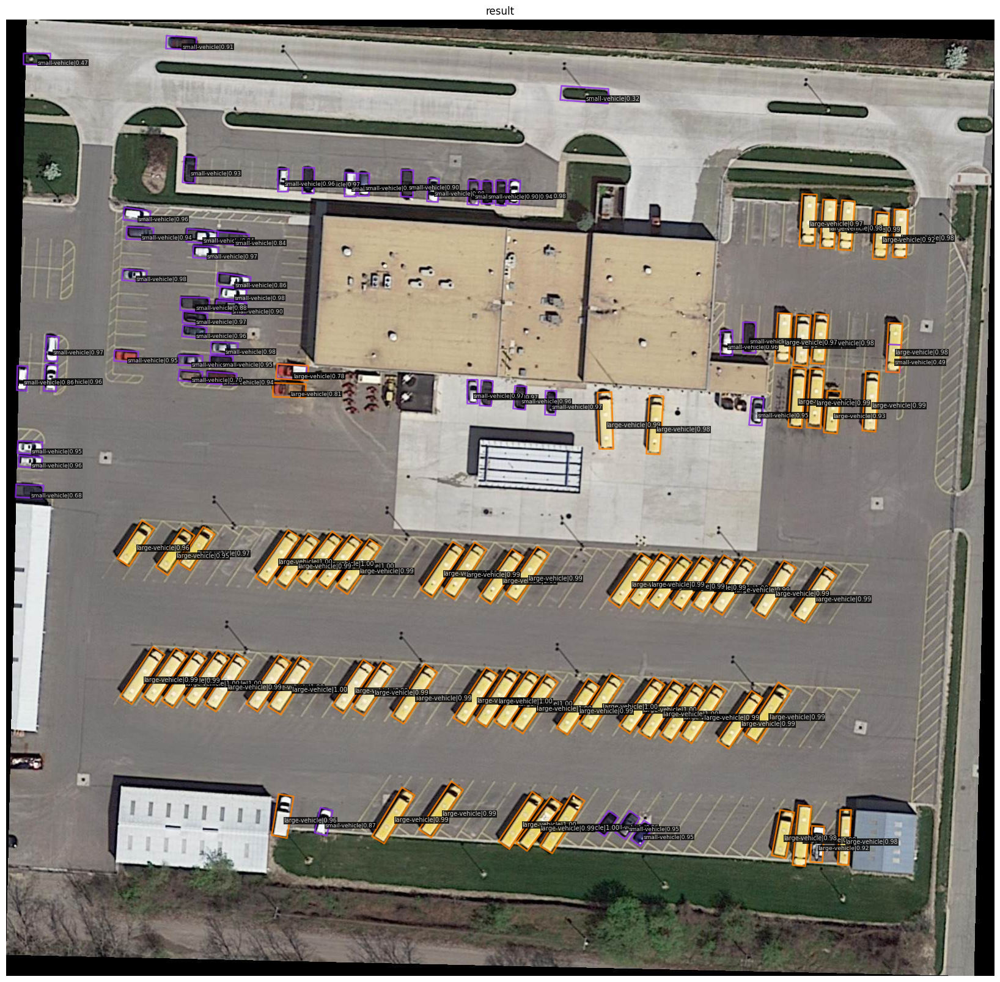

In [14]:
# Let's plot the result
show_result_pyplot(model, img, result, score_thr=0.3, palette='dota')

## Train a detector on customized dataset

To train a new detector, there are usually three things to do:
1. Support a new dataset
2. Modify the config
3. Train a new detector



### Support a new dataset

There are three ways to support a new dataset in MMRotate: 
  1. reorganize the dataset into DOTA format.
  2. reorganize the dataset into a middle format.
  3. implement a new dataset.

Usually we recommend to use the first two methods which are usually easier than the third.

In this tutorial, we gives an example that converting the data into the format of existing datasets like DOTA, etc. Other methods and more advanced usages can be found in the [doc](https://mmrotate.readthedocs.io/en/latest/tutorials/customize_dataset.html).

Firstly, let's download a SAR ship dataset obtained from [SSDD](https://github.com/TianwenZhang0825/Official-SSDD). We select the first 193 offshore images and their annotations from the dataset.

In [16]:
# Check the directory structure of the tiny data

# Install tree first
!pip install tree
!tree demo/screwdata

Folder PATH listing
Volume serial number is 00000074 140D:26DD
C:\USERS\JENSE\DOCUMENTS\PYTHON-RAPID\MMROTATE\DEMO\SCREWDATA
ÃÄÄÄimages
ÃÄÄÄtrain
ÀÄÄÄval


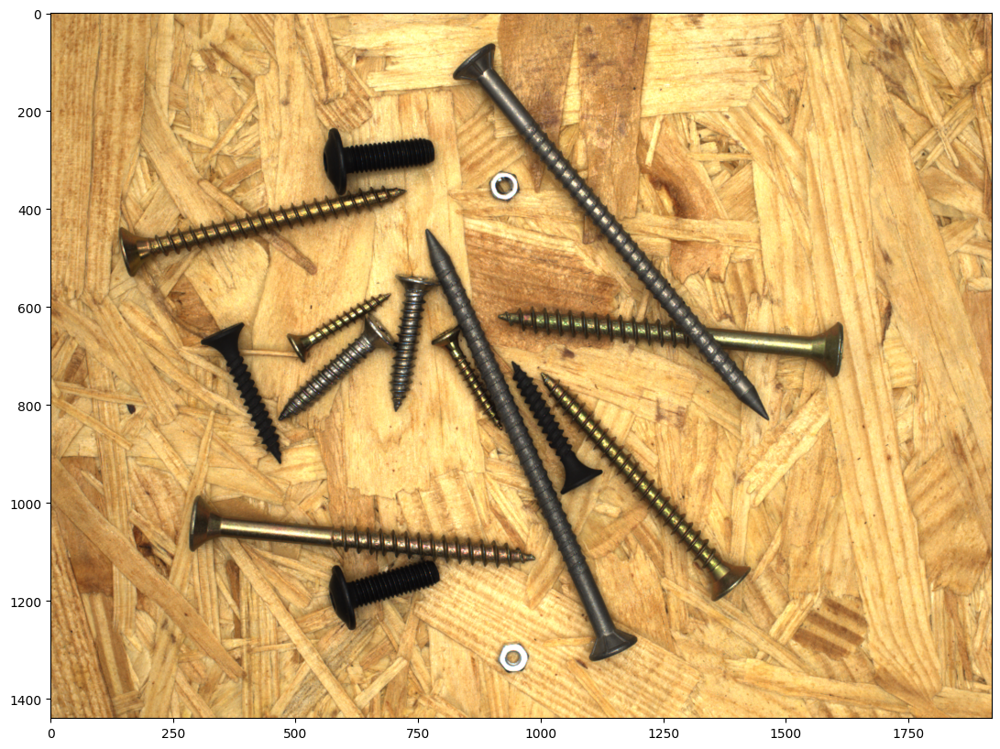

In [18]:
# Let's take a look at the dataset image
import matplotlib.pyplot as plt
img = mmcv.imread('demo/screwdata/images/screws_009.png')
plt.figure(figsize=(15, 10))
plt.imshow(mmcv.bgr2rgb(img))
plt.show()

Let's take a look at the annotation txt file.



In [19]:
# Check the label of a single image
f = open('demo/screwdata/train/screws_009.txt', 'r')
file_contents = f.read()
print (file_contents)
f.close()

912 1347 978 1347 912 1285 978 1285 nut 0
897 386 957 386 897 326 957 326 nut 0
1206 1293 814 415 1103 1339 711 461 lag_wood_screw 0
808 120 1426 871 895 48 1514 799 lag_wood_screw 0
1626 630 911 558 1614 746 899 674 long_lag_screw 0
276 1098 987 1170 287 984 999 1056 long_lag_screw 0
1436 1142 1048 692 1354 1213 966 763 wood_screw 0
156 543 741 417 133 437 718 311 wood_screw 0
561 379 796 350 544 241 779 212 bolt 0
591 1269 814 1204 553 1136 776 1072 bolt 0
301 667 428 945 392 626 519 903 black_oxide_screw 0
1132 943 994 676 1039 991 900 725 black_oxide_screw 0
658 599 427 797 721 673 490 871 shiny_screw 0
708 526 658 811 805 544 755 828 shiny_screw 0
511 717 712 602 478 659 678 544 short_wood_screw 0
772 664 891 865 830 630 949 831 short_wood_screw 0



In [20]:
from mmrotate.datasets.builder import ROTATED_DATASETS
from mmrotate.datasets.dota import DOTADataset

@ROTATED_DATASETS.register_module()
class ScrewsDataset(DOTADataset):
    """MVTEC Screws dataset for detection."""
    CLASSES = ('long_lag_screw', 'lag_wood_screw', 'wood_screw',
               'short_wood_screw', 'shiny_screw', 'black_oxide_screw',
               'nut', 'bolt', 'large_nut', 'nut', 'nut', 'machine_screw', 'short_machine_screw' )

### Import Screws dataset

In [21]:
def DOTA_2_OBB(boxes):
    #calculate the angle of the box using arctan (degrees here)
    angle = (torch.atan((boxes[:,7] - boxes[:,5])/(boxes[:,6] - boxes[:,4]))*180/np.pi).float()
    #centrepoint is the mean of adjacent points
    cx = boxes[:,[4,0]].mean(1)
    cy = boxes[:,[7,3]].mean(1)
    #calculate w and h based on the distance between adjacent points
    w = ((boxes[:,7] - boxes[:,1])**2+(boxes[:,6] - boxes[:,0])**2)**0.5
    h = ((boxes[:,1] - boxes[:,3])**2+(boxes[:,0] - boxes[:,2])**2)**0.5
    return torch.stack([cx,cy,w,h,angle]).T   

### Modify the config

In the next step, we need to modify the config for the training.
To accelerate the process, we finetune a detector using a pre-trained detector.

In [22]:
from mmcv import Config
cfg = Config.fromfile('./configs/oriented_rcnn/oriented_rcnn_r50_fpn_1x_dota_le90.py')

Given a config that trains a Oriented R-CNN on DOTA dataset, we need to modify some values to use it for training Oriented R-CNN on SSDD dataset.

In [24]:
from mmdet.apis import set_random_seed

cfg.data['workers_per_gpu']=0

# Modify dataset type and path
cfg.dataset_type = 'ScrewsDataset'
cfg.data_root = 'demo/screwdata/'

cfg.data.test.type = 'ScrewsDataset'
cfg.data.test.data_root = 'demo/screwdata/'
cfg.data.test.ann_file = 'val'
cfg.data.test.img_prefix = 'images'

cfg.data.train.type = 'ScrewsDataset'
cfg.data.train.data_root = 'demo/screwdata/'
cfg.data.train.ann_file = 'train'
cfg.data.train.img_prefix = 'images'

cfg.data.val.type = 'ScrewsDataset'
cfg.data.val.data_root = 'demo/screwdata/'
cfg.data.val.ann_file = 'val'
cfg.data.val.img_prefix = 'images'

# modify num classes of the model in box head
cfg.model.roi_head.bbox_head.num_classes = 13
# We can still use the pre-trained Mask RCNN model though we do not need to
# use the mask branch
cfg.load_from = 'oriented_rcnn_r50_fpn_1x_dota_le90-6d2b2ce0.pth'

# Set up working dir to save files and logs.
cfg.work_dir = './tutorial_exps'

cfg.optimizer.lr = 0.001
cfg.lr_config.warmup = None
cfg.runner.max_epochs = 3
cfg.log_config.interval = 10

# Change the evaluation metric since we use customized dataset.
cfg.evaluation.metric = 'mAP'
# We can set the evaluation interval to reduce the evaluation times
cfg.evaluation.interval = 3
# We can set the checkpoint saving interval to reduce the storage cost
cfg.checkpoint_config.interval = 3

# Set seed thus the results are more reproducible
cfg.seed = 0
set_random_seed(0, deterministic=False)
cfg.gpu_ids = range(1)
cfg.device='cuda'

# We can also use tensorboard to log the training process
cfg.log_config.hooks = [
    dict(type='TextLoggerHook'),
    dict(type='TensorboardLoggerHook')]

# We can initialize the logger for training and have a look
# at the final config used for training
print(f'Config:\n{cfg.pretty_text}')

Config:
dataset_type = 'ScrewsDataset'
data_root = 'demo/screwdata/'
img_norm_cfg = dict(
    mean=[123.675, 116.28, 103.53], std=[58.395, 57.12, 57.375], to_rgb=True)
train_pipeline = [
    dict(type='LoadImageFromFile'),
    dict(type='LoadAnnotations', with_bbox=True),
    dict(type='RResize', img_scale=(1024, 1024)),
    dict(
        type='RRandomFlip',
        flip_ratio=[0.25, 0.25, 0.25],
        direction=['horizontal', 'vertical', 'diagonal'],
        version='le90'),
    dict(
        type='Normalize',
        mean=[123.675, 116.28, 103.53],
        std=[58.395, 57.12, 57.375],
        to_rgb=True),
    dict(type='Pad', size_divisor=32),
    dict(type='DefaultFormatBundle'),
    dict(type='Collect', keys=['img', 'gt_bboxes', 'gt_labels'])
]
test_pipeline = [
    dict(type='LoadImageFromFile'),
    dict(
        type='MultiScaleFlipAug',
        img_scale=(1024, 1024),
        flip=False,
        transforms=[
            dict(type='RResize'),
            dict(
               

### Train a new detector

Finally, lets initialize the dataset and detector, then train a new detector!

In [25]:
import os.path as osp
from distutils.version import LooseVersion

from mmdet.datasets import build_dataset
from mmdet.models import build_detector
from mmdet.apis import train_detector

# Build dataset
datasets = [build_dataset(cfg.data.train)]

# Build the detector
model = build_detector(
    cfg.model, train_cfg=cfg.get('train_cfg'), test_cfg=cfg.get('test_cfg'))
# Add an attribute for visualization convenience
model.CLASSES = datasets[0].CLASSES

# Create work_dir
mmcv.mkdir_or_exist(osp.abspath(cfg.work_dir))
train_detector(model, datasets, cfg, distributed=False, validate=True) 

2023-06-18 22:22:01,289 - mmdet - INFO - Automatic scaling of learning rate (LR) has been disabled.
2023-06-18 22:22:01,305 - mmdet - INFO - load checkpoint from local path: oriented_rcnn_r50_fpn_1x_dota_le90-6d2b2ce0.pth
2023-06-18 22:22:01,377 - mmdet - WARNING - The model and loaded state dict do not match exactly

size mismatch for roi_head.bbox_head.fc_cls.weight: copying a param with shape torch.Size([16, 1024]) from checkpoint, the shape in current model is torch.Size([14, 1024]).
size mismatch for roi_head.bbox_head.fc_cls.bias: copying a param with shape torch.Size([16]) from checkpoint, the shape in current model is torch.Size([14]).
2023-06-18 22:22:01,386 - mmdet - INFO - Start running, host: jense@DESKTOP-225LSDS, work_dir: C:\Users\jense\Documents\Python-Rapid\mmrotate\tutorial_exps
2023-06-18 22:22:01,387 - mmdet - INFO - Hooks will be executed in the following order:
before_run:
(VERY_HIGH   ) StepLrUpdaterHook                  
(NORMAL      ) CheckpointHook            

2023-06-18 22:23:42,118 - mmdet - INFO - Epoch [2][70/135]	lr: 1.000e-03, eta: 0:01:35, time: 0.473, data_time: 0.126, memory: 3218, loss_rpn_cls: 0.0042, loss_rpn_bbox: 0.1089, loss_cls: 0.4019, acc: 88.5547, loss_bbox: 0.0849, loss: 0.6000, grad_norm: 2.2202
2023-06-18 22:23:46,828 - mmdet - INFO - Epoch [2][80/135]	lr: 1.000e-03, eta: 0:01:30, time: 0.471, data_time: 0.123, memory: 3218, loss_rpn_cls: 0.0044, loss_rpn_bbox: 0.1016, loss_cls: 0.4025, acc: 89.2480, loss_bbox: 0.0955, loss: 0.6040, grad_norm: 2.4818
2023-06-18 22:23:51,542 - mmdet - INFO - Epoch [2][90/135]	lr: 1.000e-03, eta: 0:01:26, time: 0.471, data_time: 0.123, memory: 3218, loss_rpn_cls: 0.0028, loss_rpn_bbox: 0.0841, loss_cls: 0.4018, acc: 89.1797, loss_bbox: 0.0989, loss: 0.5876, grad_norm: 2.8309
2023-06-18 22:23:56,390 - mmdet - INFO - Epoch [2][100/135]	lr: 1.000e-03, eta: 0:01:21, time: 0.485, data_time: 0.131, memory: 3218, loss_rpn_cls: 0.0028, loss_rpn_bbox: 0.0654, loss_cls: 0.3849, acc: 90.1953, loss_b

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 55/55, 6.5 task/s, elapsed: 8s, ETA:     0s

2023-06-18 22:25:35,519 - mmdet - INFO - 
+---------------------+-----+------+--------+-------+
| class               | gts | dets | recall | ap    |
+---------------------+-----+------+--------+-------+
| long_lag_screw      | 47  | 171  | 0.979  | 0.372 |
| lag_wood_screw      | 47  | 138  | 0.957  | 0.840 |
| wood_screw          | 47  | 242  | 0.957  | 0.758 |
| short_wood_screw    | 47  | 274  | 0.979  | 0.900 |
| shiny_screw         | 59  | 332  | 1.000  | 0.973 |
| black_oxide_screw   | 60  | 265  | 0.983  | 0.909 |
| nut                 | 0   | 0    | 0.000  | 0.000 |
| bolt                | 58  | 230  | 1.000  | 0.972 |
| large_nut           | 44  | 135  | 1.000  | 1.000 |
| nut                 | 0   | 0    | 0.000  | 0.000 |
| nut                 | 150 | 205  | 1.000  | 1.000 |
| machine_screw       | 44  | 177  | 1.000  | 1.000 |
| short_machine_screw | 44  | 205  | 1.000  | 0.983 |
+---------------------+-----+------+--------+-------+
| mAP                 |     |      |    

### Understand the log
From the log, we can have a basic understanding the training process and know how well the detector is trained.

Firstly, the ResNet-50 backbone pre-trained on ImageNet is loaded, this is a common practice since training from scratch is more cost. The log shows that all the weights of the ResNet-50 backbone are loaded except the `conv1.bias`, which has been merged into `conv.weights`.

Second, since the dataset we are using is small, we loaded a Oriented R-CNN model and finetune it for detection. 
The original Oriented R-CNN is trained on DOTA dataset which contains 15 classes but SSDD dataset only have 1 classes. Therefore, the last FC layer of the pre-trained Oriented R-CNN for classification has different weight shape and is not used.

Third, after training, the detector is evaluated by the default evaluation. The results show that the detector achieves over 90 mAP on the val dataset,
 not bad!

We can also check the tensorboard to see the curves.

In [26]:
# load tensorboard in colab
%load_ext tensorboard

# see curves in tensorboard
%tensorboard --logdir ./tutorial_exps

ERROR: Failed to launch TensorBoard (exited with 1).
Contents of stderr:
TensorFlow installation not found - running with reduced feature set.
Traceback (most recent call last):
  File "C:\Users\jense\anaconda3\envs\mmyolo\lib\runpy.py", line 194, in _run_module_as_main
    return _run_code(code, main_globals, None,
  File "C:\Users\jense\anaconda3\envs\mmyolo\lib\runpy.py", line 87, in _run_code
    exec(code, run_globals)
  File "C:\Users\jense\anaconda3\envs\mmyolo\Scripts\tensorboard.exe\__main__.py", line 7, in <module>
  File "C:\Users\jense\AppData\Roaming\Python\Python38\site-packages\tensorboard\main.py", line 46, in run_main
    app.run(tensorboard.main, flags_parser=tensorboard.configure)
  File "C:\Users\jense\AppData\Roaming\Python\Python38\site-packages\absl\app.py", line 308, in run
    _run_main(main, args)
  File "C:\Users\jense\AppData\Roaming\Python\Python38\site-packages\absl\app.py", line 254, in _run_main
    sys.exit(main(argv))
  File "C:\Users\jense\AppData\Roa

From the tensorboard, we can observe that changes of loss and learning rate. We can see the losses of each branch gradually decrease as the training goes by.

## Test the trained detector

After finetuning the detector, let's visualize the prediction results!

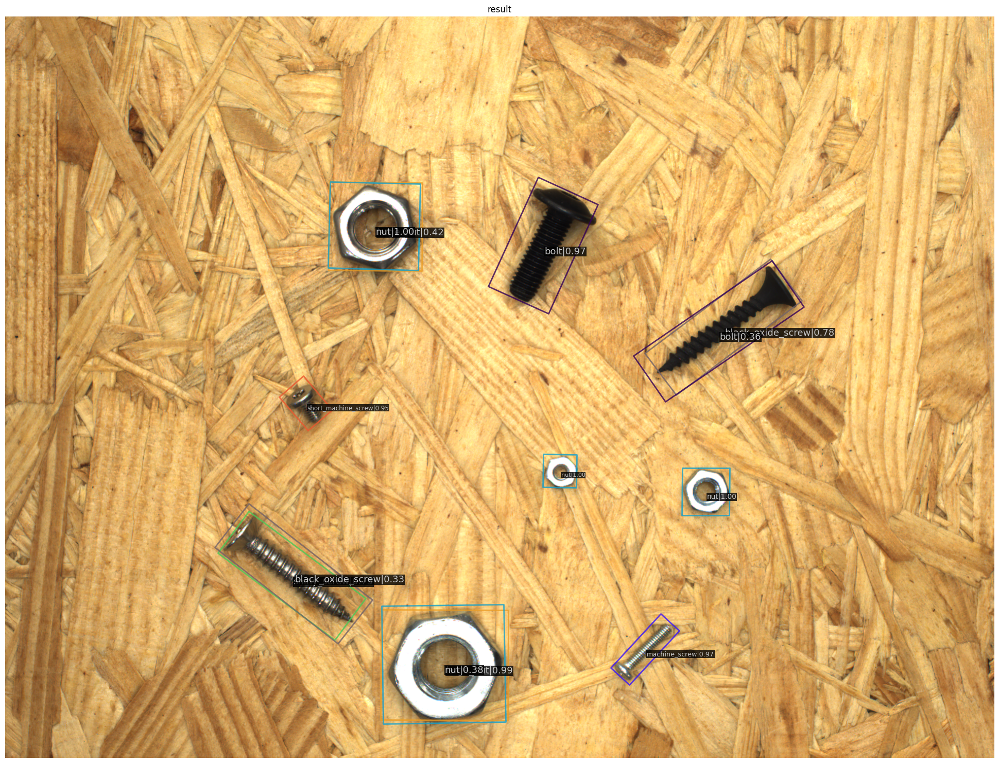

In [28]:
img = mmcv.imread('demo/screwdata/images/screws_114.png')
model.cfg = cfg
result = inference_detector(model, img)
show_result_pyplot(model, img, result, score_thr=0.3)

### Save Pytorch Model

In [37]:
torch.save(model, "../screw.pt")